# Draft code for neighbor sampling training

In [1]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv, to_hetero
from torch_geometric.data import HeteroData
from torch_geometric.loader import DataLoader
from torch import nn
from torch_geometric.utils import from_dgl
from tqdm import tqdm
from sklearn.metrics import roc_auc_score, average_precision_score, f1_score
from torch_geometric.loader import NeighborLoader

In [2]:
import data.fraud_dataset as fraud_dataset

DATASET_NAME = "yelp"
TRAIN_SIZE = 0.4
VAL_SIZE = 0.1
RANDOM_SEED = 42
FORCE_RELOAD = False

EPOCHS = 10000
TOLERATION = 100

In [3]:
fraud_data = fraud_dataset.FraudDataset(
    DATASET_NAME, 
    train_size=TRAIN_SIZE, 
    val_size=VAL_SIZE, 
    random_seed=RANDOM_SEED, 
    force_reload=FORCE_RELOAD
)
graph = fraud_data[0]

data = from_dgl(graph)
data.metadata

data['review'].num_nodes = data['review'].feature.size(0)

Done loading data from cached files.


In [4]:
import torch

def mask_label(data, observed_pct=1):
    # Ensure observed_pct is a value between 0 and 1
    assert 0 <= observed_pct <= 1, "observed_pct must be between 0 and 1"
    
    # Create a copy of the labels to modify
    label_mask = data["review"].label.clone()
    unknown_encoding = -1

    # Mask all validation and test labels
    label_mask[data["review"].val_mask.bool()] = unknown_encoding
    label_mask[data["review"].test_mask.bool()] = unknown_encoding

    # Identify the indices of the training data
    train_indices = data["review"].train_mask.nonzero(as_tuple=False).squeeze()

    # Calculate the number of training labels to mask
    num_train_labels = train_indices.size(0)
    num_to_mask = int((1 - observed_pct) * num_train_labels)

    # Randomly select indices to mask
    mask_indices = train_indices[torch.randperm(num_train_labels)[:num_to_mask]]
    label_mask[mask_indices] = unknown_encoding

    return label_mask + 1

# Example usage
masked_labels = mask_label(data, 1)
# Count the ratio of each label
print((masked_labels == 1).float().mean())  # Prints the fraction of labels that are original class 0
print((masked_labels == 2).float().mean())  # Prints the fraction of labels that are original class 1
print((masked_labels == 0).float().mean())  # Prints the fraction of labels that are masked

tensor(0.3410)
tensor(0.0590)
tensor(0.6000)


In [5]:
from lagatconv import LAGATConv


class GATWithLabels(nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels, num_labels, label_embedding_dim, heads=1, dropout=0.6):
        super(GATWithLabels, self).__init__()
        self.conv1 = LAGATConv(in_channels, hidden_channels, num_labels, label_embedding_dim, heads=heads, concat=True, dropout=dropout, bias=False)
        self.conv2 = LAGATConv(hidden_channels * heads, out_channels, num_labels, label_embedding_dim, heads=1, concat=True, bias=False)
        self.dropout = dropout

    def forward(self, x, edge_index, label_index):
        x = F.dropout(x, p=self.dropout, training=self.training)
        x = F.elu(self.conv1(x, edge_index, label_index))
        x = F.dropout(x, p=self.dropout, training=self.training)
        x = self.conv2(x, edge_index, label_index)
        return x

In [6]:
# Creating a model instance covering heterogeneity
model = GATWithLabels(in_channels=32, hidden_channels=32, label_embedding_dim=32, num_labels=3, out_channels=2, heads=2)
model = to_hetero(model, data.metadata(), aggr='sum', debug=True)

opcode         name         target                                args                                  kwargs
-------------  -----------  ------------------------------------  ------------------------------------  ----------------------------------------------
placeholder    x            x                                     ()                                    {}
placeholder    edge_index   edge_index                            ()                                    {}
placeholder    label_index  label_index                           ()                                    {}
call_function  dropout      <function dropout at 0x7fb9d63dfc40>  (x,)                                  {'p': 0.6, 'training': True, 'inplace': False}
call_module    conv1        conv1                                 (dropout, edge_index, label_index)    {}
call_function  elu          <function elu at 0x7fb9d61f0360>      (conv1,)                              {'alpha': 1.0, 'inplace': False}
call_function  dropout

/home/kaifeng/Documents/gnn_project/LAGAT/LAGAT/lib/python3.12/site-packages/torch_geometric/nn/fx.py:132: UserWarning: Found function 'dropout' with keyword argument 'training'. During FX tracing, this will likely be baked in as a constant value. Consider replacing this function by a module to properly encapsulate its training flag.
  warnings.warn(f"Found function '{node.name}' with keyword "
/home/kaifeng/Documents/gnn_project/LAGAT/LAGAT/lib/python3.12/site-packages/torch_geometric/nn/fx.py:132: UserWarning: Found function 'dropout_1' with keyword argument 'training'. During FX tracing, this will likely be baked in as a constant value. Consider replacing this function by a module to properly encapsulate its training flag.
  warnings.warn(f"Found function '{node.name}' with keyword "


In [7]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.005, weight_decay=5e-4)
label_mask = {"review": masked_labels}

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Training loop
model.train()
train_mask = data['review'].train_mask.to(device)
input_nodes = ('review', data['review'].train_mask.nonzero(as_tuple=False).squeeze())
print(input_nodes[1].shape)

n_epochs = 300
progress_bar = tqdm(range(n_epochs), desc='Training')

for epoch in progress_bar:
    total_loss = 0
    # Use NeighborLoader to get batches
    for batch in NeighborLoader(data, 
                               num_neighbors={key: [10] * 3 for key in data.edge_types}, 
                               batch_size=128, 
                               input_nodes=input_nodes):
        
        optimizer.zero_grad()
        # Get label_mask for batch
        batch_label_mask = {key: val[batch['review'].n_id] for key, val in label_mask.items()}
        
        # Mask the first batch_size labels in label_mask to 0
        batch_size = batch['review'].batch_size
        batch_label_mask['review'][:batch_size] = 0

        # # Calculate the ratio of label 0 in the batch_label_mask
        # label_0_ratio_mask = (batch_label_mask['review'] == 0).float().mean().item()
        # print(f'Label 0 ratio in batch_label_mask: {label_0_ratio_mask:.4f}')

        # Get node features and edge indices for this batch
        out = model(batch.feature_dict, batch.edge_index_dict, batch_label_mask)

        # Only compute loss for input nodes (first batch_size nodes)
        loss = F.cross_entropy(out['review'][:batch_size], batch['review'].label[:batch_size])
        
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    
    print(f'Epoch {epoch:03d}, Loss: {total_loss:.4f}')

torch.Size([18381])


Training:   0%|          | 1/300 [00:15<1:15:58, 15.25s/it]

Epoch 000, Loss: 152.8532


Training:   1%|          | 2/300 [00:30<1:15:02, 15.11s/it]

Epoch 001, Loss: 248.0240


Training:   1%|          | 3/300 [00:44<1:13:53, 14.93s/it]

Epoch 002, Loss: 233.7521


Training:   1%|▏         | 4/300 [00:59<1:12:58, 14.79s/it]

Epoch 003, Loss: 227.4610


Training:   2%|▏         | 5/300 [01:14<1:12:33, 14.76s/it]

Epoch 004, Loss: 152.0611


Training:   2%|▏         | 6/300 [01:28<1:11:54, 14.68s/it]

Epoch 005, Loss: 154.4754


Training:   2%|▏         | 7/300 [01:43<1:11:32, 14.65s/it]

Epoch 006, Loss: 149.1510


Training:   3%|▎         | 8/300 [01:57<1:10:27, 14.48s/it]

Epoch 007, Loss: 168.7761


Training:   3%|▎         | 9/300 [02:11<1:09:56, 14.42s/it]

Epoch 008, Loss: 153.2956


Training:   3%|▎         | 10/300 [02:26<1:09:30, 14.38s/it]

Epoch 009, Loss: 101.4353


Training:   4%|▎         | 11/300 [02:40<1:09:17, 14.39s/it]

Epoch 010, Loss: 158.5252


Training:   4%|▍         | 12/300 [02:55<1:09:17, 14.43s/it]

Epoch 011, Loss: 103.8558


Training:   4%|▍         | 13/300 [03:09<1:09:10, 14.46s/it]

Epoch 012, Loss: 159.9226


Training:   5%|▍         | 14/300 [03:23<1:08:56, 14.46s/it]

Epoch 013, Loss: 84.8267


Training:   5%|▌         | 15/300 [03:38<1:08:34, 14.44s/it]

Epoch 014, Loss: 166.6772


Training:   5%|▌         | 16/300 [03:52<1:08:27, 14.46s/it]

Epoch 015, Loss: 94.8438


Training:   6%|▌         | 17/300 [04:07<1:08:13, 14.46s/it]

Epoch 016, Loss: 159.1527


Training:   6%|▌         | 18/300 [04:22<1:08:17, 14.53s/it]

Epoch 017, Loss: 80.5195


Training:   6%|▋         | 19/300 [04:36<1:08:17, 14.58s/it]

Epoch 018, Loss: 160.5419


Training:   7%|▋         | 20/300 [04:51<1:08:14, 14.62s/it]

Epoch 019, Loss: 82.0127


Training:   7%|▋         | 21/300 [05:06<1:08:06, 14.65s/it]

Epoch 020, Loss: 135.8147


Training:   7%|▋         | 22/300 [05:20<1:08:02, 14.69s/it]

Epoch 021, Loss: 79.0884


Training:   8%|▊         | 23/300 [05:35<1:07:40, 14.66s/it]

Epoch 022, Loss: 169.8666


Training:   8%|▊         | 24/300 [05:50<1:07:27, 14.67s/it]

Epoch 023, Loss: 130.6016


Training:   8%|▊         | 25/300 [06:04<1:06:59, 14.62s/it]

Epoch 024, Loss: 107.9340


Training:   9%|▊         | 26/300 [06:18<1:05:54, 14.43s/it]

Epoch 025, Loss: 118.5989


Training:   9%|▉         | 27/300 [06:32<1:05:03, 14.30s/it]

Epoch 026, Loss: 95.1042


Training:   9%|▉         | 28/300 [06:46<1:04:45, 14.28s/it]

Epoch 027, Loss: 120.8445


Training:  10%|▉         | 29/300 [07:01<1:04:56, 14.38s/it]

Epoch 028, Loss: 95.2429


Training:  10%|█         | 30/300 [07:16<1:04:50, 14.41s/it]

Epoch 029, Loss: 124.1092


Training:  10%|█         | 31/300 [07:30<1:04:50, 14.46s/it]

Epoch 030, Loss: 97.2942


Training:  11%|█         | 32/300 [07:45<1:04:47, 14.51s/it]

Epoch 031, Loss: 98.9947


Training:  11%|█         | 33/300 [07:59<1:04:48, 14.56s/it]

Epoch 032, Loss: 90.6337


Training:  11%|█▏        | 34/300 [08:14<1:04:44, 14.60s/it]

Epoch 033, Loss: 111.3804


Training:  12%|█▏        | 35/300 [08:29<1:04:35, 14.62s/it]

Epoch 034, Loss: 81.2110


Training:  12%|█▏        | 36/300 [08:43<1:04:24, 14.64s/it]

Epoch 035, Loss: 110.9875


Training:  12%|█▏        | 37/300 [08:58<1:04:10, 14.64s/it]

Epoch 036, Loss: 99.1577


Training:  13%|█▎        | 38/300 [09:13<1:03:55, 14.64s/it]

Epoch 037, Loss: 86.9197


Training:  13%|█▎        | 39/300 [09:27<1:03:38, 14.63s/it]

Epoch 038, Loss: 116.2992


Training:  13%|█▎        | 40/300 [09:42<1:03:16, 14.60s/it]

Epoch 039, Loss: 97.8940


Training:  14%|█▎        | 41/300 [09:56<1:02:57, 14.59s/it]

Epoch 040, Loss: 95.2691


Training:  14%|█▍        | 42/300 [10:11<1:02:44, 14.59s/it]

Epoch 041, Loss: 85.2303


Training:  14%|█▍        | 43/300 [10:26<1:02:26, 14.58s/it]

Epoch 042, Loss: 120.9410


Training:  15%|█▍        | 44/300 [10:39<1:01:18, 14.37s/it]

Epoch 043, Loss: 101.0637


Training:  15%|█▌        | 45/300 [10:53<1:00:27, 14.23s/it]

Epoch 044, Loss: 92.7661


Training:  15%|█▌        | 46/300 [11:07<59:41, 14.10s/it]  

Epoch 045, Loss: 114.7694


Training:  16%|█▌        | 47/300 [11:21<59:03, 14.00s/it]

Epoch 046, Loss: 74.3846


Training:  16%|█▌        | 48/300 [11:35<58:39, 13.97s/it]

Epoch 047, Loss: 108.7481


Training:  16%|█▋        | 49/300 [11:49<58:36, 14.01s/it]

Epoch 048, Loss: 109.9264


Training:  17%|█▋        | 50/300 [12:03<58:50, 14.12s/it]

Epoch 049, Loss: 126.2561


Training:  17%|█▋        | 51/300 [12:18<58:58, 14.21s/it]

Epoch 050, Loss: 95.3012


Training:  17%|█▋        | 52/300 [12:32<59:03, 14.29s/it]

Epoch 051, Loss: 102.8594


Training:  18%|█▊        | 53/300 [12:47<59:30, 14.45s/it]

Epoch 052, Loss: 99.6961


Training:  18%|█▊        | 54/300 [13:02<59:25, 14.49s/it]

Epoch 053, Loss: 99.4360


Training:  18%|█▊        | 55/300 [13:16<59:22, 14.54s/it]

Epoch 054, Loss: 93.8865


Training:  19%|█▊        | 56/300 [13:31<59:20, 14.59s/it]

Epoch 055, Loss: 113.0848


Training:  19%|█▉        | 57/300 [13:46<59:01, 14.57s/it]

Epoch 056, Loss: 97.2484


Training:  19%|█▉        | 58/300 [14:00<59:08, 14.66s/it]

Epoch 057, Loss: 113.5673


Training:  20%|█▉        | 59/300 [14:15<58:45, 14.63s/it]

Epoch 058, Loss: 90.0531


Training:  20%|██        | 60/300 [14:29<58:18, 14.58s/it]

Epoch 059, Loss: 109.5567


Training:  20%|██        | 61/300 [14:44<58:13, 14.62s/it]

Epoch 060, Loss: 95.1473


Training:  21%|██        | 62/300 [14:58<57:21, 14.46s/it]

Epoch 061, Loss: 92.8245


Training:  21%|██        | 63/300 [15:12<56:32, 14.31s/it]

Epoch 062, Loss: 99.2084


Training:  21%|██▏       | 64/300 [15:26<55:56, 14.22s/it]

Epoch 063, Loss: 85.1828


Training:  22%|██▏       | 65/300 [15:40<55:23, 14.14s/it]

Epoch 064, Loss: 116.7705


Training:  22%|██▏       | 66/300 [15:54<54:55, 14.08s/it]

Epoch 065, Loss: 85.3704


Training:  22%|██▏       | 67/300 [16:08<54:32, 14.05s/it]

Epoch 066, Loss: 133.6941


Training:  23%|██▎       | 68/300 [16:22<54:23, 14.07s/it]

Epoch 067, Loss: 81.3822


Training:  23%|██▎       | 69/300 [16:36<54:24, 14.13s/it]

Epoch 068, Loss: 97.9887


Training:  23%|██▎       | 70/300 [16:51<54:28, 14.21s/it]

Epoch 069, Loss: 80.4707


Training:  24%|██▎       | 71/300 [17:05<54:39, 14.32s/it]

Epoch 070, Loss: 107.7407


Training:  24%|██▍       | 72/300 [17:20<54:57, 14.46s/it]

Epoch 071, Loss: 104.2625


Training:  24%|██▍       | 73/300 [17:35<55:06, 14.56s/it]

Epoch 072, Loss: 97.0273


Training:  25%|██▍       | 74/300 [17:50<55:13, 14.66s/it]

Epoch 073, Loss: 99.3661


Training:  25%|██▌       | 75/300 [18:05<55:08, 14.71s/it]

Epoch 074, Loss: 91.9426


Training:  25%|██▌       | 76/300 [18:19<54:57, 14.72s/it]

Epoch 075, Loss: 123.9342


Training:  26%|██▌       | 77/300 [18:34<54:45, 14.73s/it]

Epoch 076, Loss: 81.0330


Training:  26%|██▌       | 78/300 [18:49<54:35, 14.75s/it]

Epoch 077, Loss: 124.5193


Training:  26%|██▋       | 79/300 [19:04<54:24, 14.77s/it]

Epoch 078, Loss: 109.7034


Training:  27%|██▋       | 80/300 [19:18<53:17, 14.53s/it]

Epoch 079, Loss: 115.7311


Training:  27%|██▋       | 81/300 [19:32<52:20, 14.34s/it]

Epoch 080, Loss: 102.3185


Training:  27%|██▋       | 82/300 [19:46<51:38, 14.21s/it]

Epoch 081, Loss: 92.4025


Training:  28%|██▊       | 83/300 [20:00<51:08, 14.14s/it]

Epoch 082, Loss: 111.9536


Training:  28%|██▊       | 84/300 [20:14<50:42, 14.09s/it]

Epoch 083, Loss: 89.8542


Training:  28%|██▊       | 85/300 [20:28<50:19, 14.05s/it]

Epoch 084, Loss: 92.1358


Training:  29%|██▊       | 86/300 [20:42<50:11, 14.07s/it]

Epoch 085, Loss: 122.2831


Training:  29%|██▉       | 87/300 [20:56<50:20, 14.18s/it]

Epoch 086, Loss: 85.8316


Training:  29%|██▉       | 88/300 [21:11<50:21, 14.25s/it]

Epoch 087, Loss: 97.7872


Training:  30%|██▉       | 89/300 [21:25<50:23, 14.33s/it]

Epoch 088, Loss: 93.2158


Training:  30%|███       | 90/300 [21:40<50:20, 14.38s/it]

Epoch 089, Loss: 131.0190


Training:  30%|███       | 91/300 [21:54<50:31, 14.51s/it]

Epoch 090, Loss: 118.2560


Training:  31%|███       | 92/300 [22:09<50:28, 14.56s/it]

Epoch 091, Loss: 77.2456


Training:  31%|███       | 93/300 [22:24<50:29, 14.63s/it]

Epoch 092, Loss: 134.7173


Training:  31%|███▏      | 94/300 [22:39<50:32, 14.72s/it]

Epoch 093, Loss: 103.8162


Training:  32%|███▏      | 95/300 [22:54<50:27, 14.77s/it]

Epoch 094, Loss: 102.0119


Training:  32%|███▏      | 96/300 [23:08<50:01, 14.72s/it]

Epoch 095, Loss: 96.5362


Training:  32%|███▏      | 97/300 [23:23<49:37, 14.67s/it]

Epoch 096, Loss: 83.9935


Training:  33%|███▎      | 98/300 [23:37<48:38, 14.45s/it]

Epoch 097, Loss: 105.6837


Training:  33%|███▎      | 99/300 [23:51<47:52, 14.29s/it]

Epoch 098, Loss: 83.7545


Training:  33%|███▎      | 100/300 [24:04<47:10, 14.15s/it]

Epoch 099, Loss: 99.7363


Training:  34%|███▎      | 101/300 [24:18<46:37, 14.06s/it]

Epoch 100, Loss: 82.9832


Training:  34%|███▍      | 102/300 [24:32<46:12, 14.00s/it]

Epoch 101, Loss: 98.0523


Training:  34%|███▍      | 103/300 [24:46<45:52, 13.97s/it]

Epoch 102, Loss: 88.2323


Training:  35%|███▍      | 104/300 [25:00<45:32, 13.94s/it]

Epoch 103, Loss: 153.2029


Training:  35%|███▌      | 105/300 [25:14<45:20, 13.95s/it]

Epoch 104, Loss: 99.2888


Training:  35%|███▌      | 106/300 [25:28<45:28, 14.06s/it]

Epoch 105, Loss: 101.3016


Training:  36%|███▌      | 107/300 [25:43<45:41, 14.20s/it]

Epoch 106, Loss: 109.8097


Training:  36%|███▌      | 108/300 [25:57<45:43, 14.29s/it]

Epoch 107, Loss: 77.5394


Training:  36%|███▋      | 109/300 [26:12<45:42, 14.36s/it]

Epoch 108, Loss: 132.7769


Training:  37%|███▋      | 110/300 [26:26<45:42, 14.44s/it]

Epoch 109, Loss: 84.0915


Training:  37%|███▋      | 111/300 [26:41<45:44, 14.52s/it]

Epoch 110, Loss: 144.1395


Training:  37%|███▋      | 112/300 [26:56<45:45, 14.60s/it]

Epoch 111, Loss: 96.8781


Training:  38%|███▊      | 113/300 [27:11<45:49, 14.70s/it]

Epoch 112, Loss: 115.4700


Training:  38%|███▊      | 114/300 [27:26<45:36, 14.71s/it]

Epoch 113, Loss: 80.2565


Training:  38%|███▊      | 115/300 [27:40<45:20, 14.70s/it]

Epoch 114, Loss: 102.2520


Training:  39%|███▊      | 116/300 [27:54<44:25, 14.49s/it]

Epoch 115, Loss: 86.0219


Training:  39%|███▉      | 117/300 [28:08<43:44, 14.34s/it]

Epoch 116, Loss: 107.4882


Training:  39%|███▉      | 118/300 [28:22<43:07, 14.22s/it]

Epoch 117, Loss: 79.4147


Training:  40%|███▉      | 119/300 [28:36<42:32, 14.10s/it]

Epoch 118, Loss: 114.1836


Training:  40%|████      | 120/300 [28:50<42:06, 14.03s/it]

Epoch 119, Loss: 94.1820


Training:  40%|████      | 121/300 [29:04<41:44, 13.99s/it]

Epoch 120, Loss: 90.6107


Training:  41%|████      | 122/300 [29:18<41:23, 13.95s/it]

Epoch 121, Loss: 85.8921


Training:  41%|████      | 123/300 [29:32<41:08, 13.95s/it]

Epoch 122, Loss: 98.3544


Training:  41%|████▏     | 124/300 [29:46<41:00, 13.98s/it]

Epoch 123, Loss: 93.1602


Training:  42%|████▏     | 125/300 [30:00<40:57, 14.04s/it]

Epoch 124, Loss: 98.4116


Training:  42%|████▏     | 126/300 [30:14<41:01, 14.15s/it]

Epoch 125, Loss: 105.0397


Training:  42%|████▏     | 127/300 [30:29<41:13, 14.30s/it]

Epoch 126, Loss: 115.0608


Training:  43%|████▎     | 128/300 [30:44<41:19, 14.41s/it]

Epoch 127, Loss: 92.0497


Training:  43%|████▎     | 129/300 [30:58<41:18, 14.49s/it]

Epoch 128, Loss: 102.9017


Training:  43%|████▎     | 130/300 [31:13<41:16, 14.57s/it]

Epoch 129, Loss: 79.3210


Training:  44%|████▎     | 131/300 [31:28<41:07, 14.60s/it]

Epoch 130, Loss: 114.9087


Training:  44%|████▍     | 132/300 [31:42<41:04, 14.67s/it]

Epoch 131, Loss: 77.1692


Training:  44%|████▍     | 133/300 [31:57<40:52, 14.68s/it]

Epoch 132, Loss: 124.1574


Training:  45%|████▍     | 134/300 [32:11<40:01, 14.47s/it]

Epoch 133, Loss: 81.7269


Training:  45%|████▌     | 135/300 [32:25<39:19, 14.30s/it]

Epoch 134, Loss: 88.5131


Training:  45%|████▌     | 136/300 [32:39<38:44, 14.17s/it]

Epoch 135, Loss: 105.1588


Training:  46%|████▌     | 137/300 [32:53<38:14, 14.08s/it]

Epoch 136, Loss: 91.7168


Training:  46%|████▌     | 138/300 [33:07<37:46, 13.99s/it]

Epoch 137, Loss: 100.4839


Training:  46%|████▋     | 139/300 [33:20<37:23, 13.94s/it]

Epoch 138, Loss: 76.3161


Training:  47%|████▋     | 140/300 [33:34<37:05, 13.91s/it]

Epoch 139, Loss: 128.7161


Training:  47%|████▋     | 141/300 [33:48<36:52, 13.92s/it]

Epoch 140, Loss: 88.3542


Training:  47%|████▋     | 142/300 [34:02<36:43, 13.95s/it]

Epoch 141, Loss: 110.1329


Training:  48%|████▊     | 143/300 [34:16<36:42, 14.03s/it]

Epoch 142, Loss: 91.1921


Training:  48%|████▊     | 144/300 [34:31<36:44, 14.13s/it]

Epoch 143, Loss: 91.4443


Training:  48%|████▊     | 145/300 [34:45<36:41, 14.20s/it]

Epoch 144, Loss: 99.2753


Training:  49%|████▊     | 146/300 [35:00<36:38, 14.28s/it]

Epoch 145, Loss: 83.0367


Training:  49%|████▉     | 147/300 [35:14<36:38, 14.37s/it]

Epoch 146, Loss: 101.2392


Training:  49%|████▉     | 148/300 [35:29<36:30, 14.41s/it]

Epoch 147, Loss: 98.9191


Training:  50%|████▉     | 149/300 [35:43<36:24, 14.46s/it]

Epoch 148, Loss: 106.8081


Training:  50%|█████     | 150/300 [35:58<36:13, 14.49s/it]

Epoch 149, Loss: 93.1282


Training:  50%|█████     | 151/300 [36:13<36:08, 14.55s/it]

Epoch 150, Loss: 103.9055


Training:  51%|█████     | 152/300 [36:27<35:29, 14.39s/it]

Epoch 151, Loss: 92.8503


Training:  51%|█████     | 153/300 [36:40<34:52, 14.23s/it]

Epoch 152, Loss: 77.4473


Training:  51%|█████▏    | 154/300 [36:54<34:22, 14.13s/it]

Epoch 153, Loss: 106.5137


Training:  52%|█████▏    | 155/300 [37:09<34:12, 14.15s/it]

Epoch 154, Loss: 95.2184


Training:  52%|█████▏    | 156/300 [37:22<33:49, 14.09s/it]

Epoch 155, Loss: 106.6966


Training:  52%|█████▏    | 157/300 [37:36<33:28, 14.04s/it]

Epoch 156, Loss: 132.0700


Training:  53%|█████▎    | 158/300 [37:50<33:07, 14.00s/it]

Epoch 157, Loss: 90.0301


Training:  53%|█████▎    | 159/300 [38:04<32:52, 13.99s/it]

Epoch 158, Loss: 119.3952


Training:  53%|█████▎    | 160/300 [38:18<32:40, 14.01s/it]

Epoch 159, Loss: 110.8846


Training:  54%|█████▎    | 161/300 [38:33<32:35, 14.07s/it]

Epoch 160, Loss: 86.6585


Training:  54%|█████▍    | 162/300 [38:47<32:37, 14.19s/it]

Epoch 161, Loss: 86.0284


Training:  54%|█████▍    | 163/300 [39:02<32:37, 14.29s/it]

Epoch 162, Loss: 101.3985


Training:  55%|█████▍    | 164/300 [39:16<32:33, 14.36s/it]

Epoch 163, Loss: 75.7590


Training:  55%|█████▌    | 165/300 [39:31<32:29, 14.44s/it]

Epoch 164, Loss: 108.4589


Training:  55%|█████▌    | 166/300 [39:45<32:29, 14.55s/it]

Epoch 165, Loss: 102.1427


Training:  56%|█████▌    | 167/300 [40:00<32:27, 14.64s/it]

Epoch 166, Loss: 113.8049


Training:  56%|█████▌    | 168/300 [40:15<32:16, 14.67s/it]

Epoch 167, Loss: 75.9487


Training:  56%|█████▋    | 169/300 [40:30<32:06, 14.70s/it]

Epoch 168, Loss: 100.5508


Training:  57%|█████▋    | 170/300 [40:44<31:32, 14.56s/it]

Epoch 169, Loss: 76.9451


Training:  57%|█████▋    | 171/300 [40:58<31:01, 14.43s/it]

Epoch 170, Loss: 92.2423


Training:  57%|█████▋    | 172/300 [41:12<30:32, 14.32s/it]

Epoch 171, Loss: 94.4678


Training:  58%|█████▊    | 173/300 [41:26<30:07, 14.23s/it]

Epoch 172, Loss: 92.7402


Training:  58%|█████▊    | 174/300 [41:40<29:47, 14.19s/it]

Epoch 173, Loss: 95.4347


Training:  58%|█████▊    | 175/300 [41:54<29:28, 14.15s/it]

Epoch 174, Loss: 92.7237


Training:  59%|█████▊    | 176/300 [42:08<29:10, 14.12s/it]

Epoch 175, Loss: 102.3539


Training:  59%|█████▉    | 177/300 [42:23<28:54, 14.10s/it]

Epoch 176, Loss: 89.7811


Training:  59%|█████▉    | 178/300 [42:37<28:40, 14.10s/it]

Epoch 177, Loss: 107.1835


Training:  60%|█████▉    | 179/300 [42:51<28:41, 14.23s/it]

Epoch 178, Loss: 104.0463


Training:  60%|██████    | 180/300 [43:06<28:41, 14.35s/it]

Epoch 179, Loss: 83.7157


Training:  60%|██████    | 181/300 [43:20<28:36, 14.43s/it]

Epoch 180, Loss: 113.1365


Training:  61%|██████    | 182/300 [43:35<28:34, 14.53s/it]

Epoch 181, Loss: 108.4874


Training:  61%|██████    | 183/300 [43:50<28:29, 14.61s/it]

Epoch 182, Loss: 87.3212


Training:  61%|██████▏   | 184/300 [44:05<28:20, 14.66s/it]

Epoch 183, Loss: 97.7574


Training:  62%|██████▏   | 185/300 [44:20<28:09, 14.70s/it]

Epoch 184, Loss: 98.7190


Training:  62%|██████▏   | 186/300 [44:34<27:56, 14.70s/it]

Epoch 185, Loss: 102.0380


Training:  62%|██████▏   | 187/300 [44:49<27:45, 14.74s/it]

Epoch 186, Loss: 93.3348


Training:  63%|██████▎   | 188/300 [45:03<27:07, 14.53s/it]

Epoch 187, Loss: 92.4617


Training:  63%|██████▎   | 189/300 [45:17<26:34, 14.36s/it]

Epoch 188, Loss: 75.1513


Training:  63%|██████▎   | 190/300 [45:31<26:07, 14.25s/it]

Epoch 189, Loss: 106.9671


Training:  64%|██████▎   | 191/300 [45:45<25:46, 14.18s/it]

Epoch 190, Loss: 81.0582


Training:  64%|██████▍   | 192/300 [45:59<25:25, 14.13s/it]

Epoch 191, Loss: 115.7742


Training:  64%|██████▍   | 193/300 [46:13<25:07, 14.09s/it]

Epoch 192, Loss: 87.0023


Training:  65%|██████▍   | 194/300 [46:27<24:52, 14.08s/it]

Epoch 193, Loss: 87.8265


Training:  65%|██████▌   | 195/300 [46:41<24:39, 14.09s/it]

Epoch 194, Loss: 118.3654


Training:  65%|██████▌   | 196/300 [46:55<24:26, 14.10s/it]

Epoch 195, Loss: 77.3856


Training:  66%|██████▌   | 197/300 [47:10<24:20, 14.18s/it]

Epoch 196, Loss: 107.9338


Training:  66%|██████▌   | 198/300 [47:24<24:14, 14.26s/it]

Epoch 197, Loss: 90.4568


Training:  66%|██████▋   | 199/300 [47:39<24:14, 14.40s/it]

Epoch 198, Loss: 102.3546


Training:  67%|██████▋   | 200/300 [47:54<24:08, 14.49s/it]

Epoch 199, Loss: 79.8058


Training:  67%|██████▋   | 201/300 [48:09<24:10, 14.65s/it]

Epoch 200, Loss: 159.0543


Training:  67%|██████▋   | 202/300 [48:23<24:00, 14.70s/it]

Epoch 201, Loss: 100.1183


Training:  68%|██████▊   | 203/300 [48:38<23:48, 14.73s/it]

Epoch 202, Loss: 96.2689


Training:  68%|██████▊   | 204/300 [48:53<23:46, 14.86s/it]

Epoch 203, Loss: 93.3573


Training:  68%|██████▊   | 205/300 [49:09<23:39, 14.95s/it]

Epoch 204, Loss: 92.7682


Training:  69%|██████▊   | 206/300 [49:23<23:01, 14.69s/it]

Epoch 205, Loss: 87.1430


Training:  69%|██████▉   | 207/300 [49:37<22:25, 14.47s/it]

Epoch 206, Loss: 132.7737


Training:  69%|██████▉   | 208/300 [49:51<21:55, 14.30s/it]

Epoch 207, Loss: 92.9597


Training:  70%|██████▉   | 209/300 [50:05<21:36, 14.25s/it]

Epoch 208, Loss: 101.0643


Training:  70%|███████   | 210/300 [50:19<21:18, 14.21s/it]

Epoch 209, Loss: 81.4966


Training:  70%|███████   | 211/300 [50:33<21:00, 14.17s/it]

Epoch 210, Loss: 89.2329


Training:  71%|███████   | 212/300 [50:47<20:36, 14.05s/it]

Epoch 211, Loss: 105.1338


Training:  71%|███████   | 213/300 [51:00<20:14, 13.96s/it]

Epoch 212, Loss: 100.0266


Training:  71%|███████▏  | 214/300 [51:14<19:57, 13.93s/it]

Epoch 213, Loss: 87.6730


Training:  72%|███████▏  | 215/300 [51:28<19:39, 13.88s/it]

Epoch 214, Loss: 89.0793


Training:  72%|███████▏  | 216/300 [51:42<19:23, 13.86s/it]

Epoch 215, Loss: 82.6787


Training:  72%|███████▏  | 217/300 [51:56<19:12, 13.89s/it]

Epoch 216, Loss: 108.7140


Training:  73%|███████▎  | 218/300 [52:10<19:04, 13.96s/it]

Epoch 217, Loss: 81.5127


Training:  73%|███████▎  | 219/300 [52:24<19:02, 14.10s/it]

Epoch 218, Loss: 117.3711


Training:  73%|███████▎  | 220/300 [52:39<18:55, 14.19s/it]

Epoch 219, Loss: 83.2669


Training:  74%|███████▎  | 221/300 [52:53<18:47, 14.28s/it]

Epoch 220, Loss: 133.7252


Training:  74%|███████▍  | 222/300 [53:08<18:38, 14.33s/it]

Epoch 221, Loss: 94.4416


Training:  74%|███████▍  | 223/300 [53:22<18:30, 14.42s/it]

Epoch 222, Loss: 100.2143


Training:  75%|███████▍  | 224/300 [53:36<18:02, 14.24s/it]

Epoch 223, Loss: 88.0180


Training:  75%|███████▌  | 225/300 [53:50<17:36, 14.09s/it]

Epoch 224, Loss: 98.9184


Training:  75%|███████▌  | 226/300 [54:04<17:14, 13.98s/it]

Epoch 225, Loss: 97.9759


Training:  76%|███████▌  | 227/300 [54:17<16:55, 13.91s/it]

Epoch 226, Loss: 101.7077


Training:  76%|███████▌  | 228/300 [54:31<16:37, 13.85s/it]

Epoch 227, Loss: 89.0874


Training:  76%|███████▋  | 229/300 [54:45<16:20, 13.81s/it]

Epoch 228, Loss: 105.2118


Training:  77%|███████▋  | 230/300 [54:58<16:04, 13.77s/it]

Epoch 229, Loss: 85.9800


Training:  77%|███████▋  | 231/300 [55:12<15:48, 13.74s/it]

Epoch 230, Loss: 99.4309


Training:  77%|███████▋  | 232/300 [55:26<15:34, 13.74s/it]

Epoch 231, Loss: 96.2232


Training:  78%|███████▊  | 233/300 [55:40<15:22, 13.77s/it]

Epoch 232, Loss: 83.7139


Training:  78%|███████▊  | 234/300 [55:54<15:10, 13.80s/it]

Epoch 233, Loss: 94.5462


Training:  78%|███████▊  | 235/300 [56:08<15:01, 13.87s/it]

Epoch 234, Loss: 92.7336


Training:  79%|███████▊  | 236/300 [56:22<14:57, 14.02s/it]

Epoch 235, Loss: 96.5694


Training:  79%|███████▉  | 237/300 [56:38<15:14, 14.52s/it]

Epoch 236, Loss: 109.7610


Training:  79%|███████▉  | 238/300 [56:53<15:14, 14.74s/it]

Epoch 237, Loss: 98.6845


Training:  80%|███████▉  | 239/300 [57:08<15:04, 14.83s/it]

Epoch 238, Loss: 83.8699


Training:  80%|████████  | 240/300 [57:23<14:51, 14.85s/it]

Epoch 239, Loss: 131.5744


Training:  80%|████████  | 241/300 [57:38<14:36, 14.86s/it]

Epoch 240, Loss: 78.1439


Training:  81%|████████  | 242/300 [57:52<14:09, 14.65s/it]

Epoch 241, Loss: 100.1843


Training:  81%|████████  | 243/300 [58:06<13:44, 14.46s/it]

Epoch 242, Loss: 79.2765


Training:  81%|████████▏ | 244/300 [58:20<13:24, 14.37s/it]

Epoch 243, Loss: 95.6145


Training:  82%|████████▏ | 245/300 [58:34<13:06, 14.30s/it]

Epoch 244, Loss: 83.8620


Training:  82%|████████▏ | 246/300 [58:48<12:50, 14.27s/it]

Epoch 245, Loss: 101.1307


Training:  82%|████████▏ | 247/300 [59:03<12:34, 14.23s/it]

Epoch 246, Loss: 103.6497


Training:  83%|████████▎ | 248/300 [59:17<12:20, 14.24s/it]

Epoch 247, Loss: 125.4764


Training:  83%|████████▎ | 249/300 [59:31<12:11, 14.34s/it]

Epoch 248, Loss: 108.3931


Training:  83%|████████▎ | 250/300 [59:45<11:52, 14.25s/it]

Epoch 249, Loss: 99.4967


Training:  84%|████████▎ | 251/300 [1:00:00<11:40, 14.29s/it]

Epoch 250, Loss: 100.0833


Training:  84%|████████▍ | 252/300 [1:00:14<11:26, 14.31s/it]

Epoch 251, Loss: 126.4281


Training:  84%|████████▍ | 253/300 [1:00:28<11:12, 14.30s/it]

Epoch 252, Loss: 83.9421


Training:  85%|████████▍ | 254/300 [1:00:43<10:59, 14.34s/it]

Epoch 253, Loss: 114.9878


Training:  85%|████████▌ | 255/300 [1:00:58<10:50, 14.47s/it]

Epoch 254, Loss: 85.2741


Training:  85%|████████▌ | 256/300 [1:01:12<10:41, 14.58s/it]

Epoch 255, Loss: 115.7702


Training:  86%|████████▌ | 257/300 [1:01:27<10:30, 14.66s/it]

Epoch 256, Loss: 103.6742


Training:  86%|████████▌ | 258/300 [1:01:42<10:18, 14.73s/it]

Epoch 257, Loss: 89.1239


Training:  86%|████████▋ | 259/300 [1:01:57<10:06, 14.78s/it]

Epoch 258, Loss: 92.2873


Training:  87%|████████▋ | 260/300 [1:02:11<09:44, 14.62s/it]

Epoch 259, Loss: 111.1151


Training:  87%|████████▋ | 261/300 [1:02:25<09:22, 14.42s/it]

Epoch 260, Loss: 87.3377


Training:  87%|████████▋ | 262/300 [1:02:39<09:02, 14.27s/it]

Epoch 261, Loss: 96.6615


Training:  88%|████████▊ | 263/300 [1:02:53<08:42, 14.13s/it]

Epoch 262, Loss: 100.0460


Training:  88%|████████▊ | 264/300 [1:03:07<08:26, 14.06s/it]

Epoch 263, Loss: 86.4176


Training:  88%|████████▊ | 265/300 [1:03:21<08:10, 14.02s/it]

Epoch 264, Loss: 101.4346


Training:  89%|████████▊ | 266/300 [1:03:35<07:55, 13.99s/it]

Epoch 265, Loss: 90.2550


Training:  89%|████████▉ | 267/300 [1:03:49<07:41, 13.99s/it]

Epoch 266, Loss: 84.3135


Training:  89%|████████▉ | 268/300 [1:04:03<07:26, 13.95s/it]

Epoch 267, Loss: 96.6657


Training:  90%|████████▉ | 269/300 [1:04:16<07:11, 13.93s/it]

Epoch 268, Loss: 103.6035


Training:  90%|█████████ | 270/300 [1:04:30<06:58, 13.96s/it]

Epoch 269, Loss: 115.9946


Training:  90%|█████████ | 271/300 [1:04:44<06:44, 13.94s/it]

Epoch 270, Loss: 91.9075


Training:  91%|█████████ | 272/300 [1:04:58<06:30, 13.95s/it]

Epoch 271, Loss: 121.1780


Training:  91%|█████████ | 273/300 [1:05:12<06:16, 13.96s/it]

Epoch 272, Loss: 90.1569


Training:  91%|█████████▏| 274/300 [1:05:27<06:04, 14.03s/it]

Epoch 273, Loss: 86.6520


Training:  92%|█████████▏| 275/300 [1:05:41<05:54, 14.17s/it]

Epoch 274, Loss: 112.1843


Training:  92%|█████████▏| 276/300 [1:05:56<05:43, 14.32s/it]

Epoch 275, Loss: 84.4038


Training:  92%|█████████▏| 277/300 [1:06:10<05:31, 14.42s/it]

Epoch 276, Loss: 90.9239


Training:  93%|█████████▎| 278/300 [1:06:24<05:14, 14.30s/it]

Epoch 277, Loss: 94.1854


Training:  93%|█████████▎| 279/300 [1:06:38<04:58, 14.20s/it]

Epoch 278, Loss: 97.3143


Training:  93%|█████████▎| 280/300 [1:06:52<04:42, 14.13s/it]

Epoch 279, Loss: 87.8799


Training:  94%|█████████▎| 281/300 [1:07:06<04:27, 14.08s/it]

Epoch 280, Loss: 98.9720


Training:  94%|█████████▍| 282/300 [1:07:20<04:12, 14.04s/it]

Epoch 281, Loss: 81.5305


Training:  94%|█████████▍| 283/300 [1:07:34<03:58, 14.03s/it]

Epoch 282, Loss: 97.4298


Training:  95%|█████████▍| 284/300 [1:07:48<03:44, 14.01s/it]

Epoch 283, Loss: 90.4975


Training:  95%|█████████▌| 285/300 [1:08:02<03:30, 14.01s/it]

Epoch 284, Loss: 96.9413


Training:  95%|█████████▌| 286/300 [1:08:16<03:16, 14.00s/it]

Epoch 285, Loss: 98.2056


Training:  96%|█████████▌| 287/300 [1:08:30<03:02, 14.00s/it]

Epoch 286, Loss: 97.0197


Training:  96%|█████████▌| 288/300 [1:08:44<02:47, 14.00s/it]

Epoch 287, Loss: 96.2514


Training:  96%|█████████▋| 289/300 [1:08:58<02:33, 13.99s/it]

Epoch 288, Loss: 99.5308


Training:  97%|█████████▋| 290/300 [1:09:12<02:19, 13.98s/it]

Epoch 289, Loss: 115.1054


Training:  97%|█████████▋| 291/300 [1:09:26<02:06, 14.02s/it]

Epoch 290, Loss: 119.0292


Training:  97%|█████████▋| 292/300 [1:09:40<01:52, 14.09s/it]

Epoch 291, Loss: 83.7107


Training:  98%|█████████▊| 293/300 [1:09:55<01:39, 14.27s/it]

Epoch 292, Loss: 110.3861


Training:  98%|█████████▊| 294/300 [1:10:10<01:26, 14.41s/it]

Epoch 293, Loss: 93.8037


Training:  98%|█████████▊| 295/300 [1:10:25<01:12, 14.54s/it]

Epoch 294, Loss: 91.6020


Training:  99%|█████████▊| 296/300 [1:10:39<00:57, 14.37s/it]

Epoch 295, Loss: 98.2258


Training:  99%|█████████▉| 297/300 [1:10:53<00:42, 14.25s/it]

Epoch 296, Loss: 100.1214


Training:  99%|█████████▉| 298/300 [1:11:07<00:28, 14.15s/it]

Epoch 297, Loss: 106.8036


Training: 100%|█████████▉| 299/300 [1:11:21<00:14, 14.08s/it]

Epoch 298, Loss: 112.3679


Training: 100%|██████████| 300/300 [1:11:34<00:00, 14.32s/it]

Epoch 299, Loss: 91.4823


In [12]:
# save model
torch.save(model.state_dict(), 'model.pt')

Batch size: 2
Node IDs: [32, 14, 33, 8, 2, 15, 18, 23, 20, 29, 31, 22, 30, 26, 27, 28, 9, 13, 19, 0, 3, 7, 1, 25, 24]
Edge IDs: [155, 74, 59, 34, 76, 82, 96, 87, 115, 125, 91, 119, 142, 129, 97, 77, 105, 109, 112, 116, 92, 120, 60, 88, 62, 73, 126, 138, 86, 83, 75, 29, 7, 118, 128, 139, 37, 57, 54, 61, 1, 71, 17, 106, 110, 127, 143, 130, 131, 144, 134, 113, 148, 107, 101, 146, 132, 95, 135, 104, 152, 103, 15, 137, 100, 154, 111, 133, 147, 153, 136, 58, 24]
Input IDs: [0, 1]
Number of sampled nodes: [2, 11, 12]
torch.Size([2, 73])
torch.Size([25, 34])


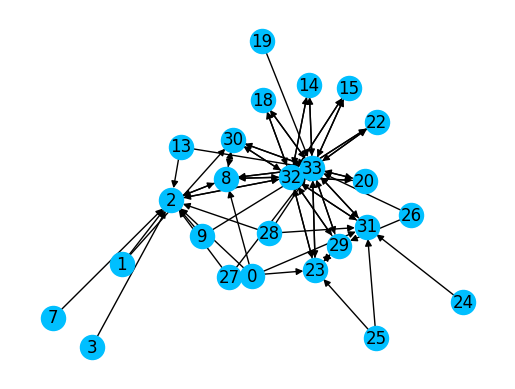

Batch size: 2
Node IDs: [11, 0, 6, 10, 2, 12, 13, 8, 3, 1, 17, 19, 21, 5, 7, 4, 31, 16, 9, 27, 28, 32, 33, 30, 25, 24]
Edge IDs: [9, 48, 63, 66, 25, 67, 69, 56, 35, 16, 80, 84, 89, 44, 52, 41, 121, 45, 42, 5, 79, 8, 46, 43, 37, 57, 54, 61, 1, 71, 17, 106, 110, 127, 10, 39, 141, 31, 20, 40, 11, 29, 7, 118, 128, 139, 27, 68, 72, 18, 55, 2, 117, 26, 70, 85, 53, 36, 0, 90, 81, 12, 21, 13, 22, 145, 23, 14, 78, 50, 65, 4, 6, 38, 28, 19, 64, 3, 49, 103, 15, 137, 100, 154, 111]
Input IDs: [2, 3]
Number of sampled nodes: [2, 15, 9]
torch.Size([2, 85])
torch.Size([26, 34])


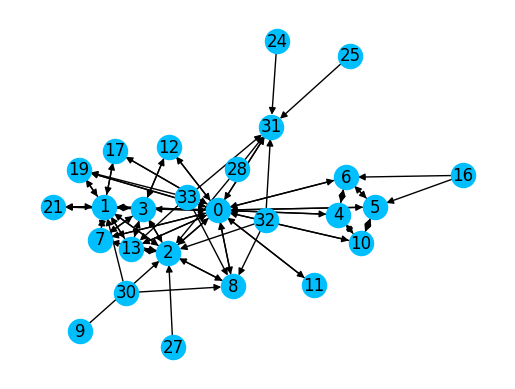

In [8]:
import torch
from torch_geometric.datasets import KarateClub
from torch_geometric.utils import to_networkx
import networkx as nx
import matplotlib.pyplot as plt
from torch_geometric.loader import NeighborLoader

def draw(graph):
    nids = graph.n_id
    graph = to_networkx(graph)
    for i, nid in enumerate(nids):
        graph.nodes[i]['txt'] = str(nid.item())
    node_labels = nx.get_node_attributes(graph, 'txt')
    # print(node_labels)
    # {0: '14', 1: '32', 2: '33', 3: '18', 4: '30', 5: '28', 6: '20'}
    nx.draw_networkx(graph, labels=node_labels, node_color='#00BFFF')
    plt.axis("off")
    plt.show()

dataset = KarateClub()
g = dataset[0]
# print(g)
# Data(x=[34, 34], edge_index=[2, 156], y=[34], train_mask=[34])
g.n_id = torch.arange(g.num_nodes)

for s in NeighborLoader(g, num_neighbors=[-1, -1], batch_size = 2, input_nodes=torch.Tensor([32, 14, 11, 0])):
    print(f"Batch size: {s.batch_size}")
    print(f"Node IDs: {s.n_id.tolist()}")
    print(f"Edge IDs: {s.e_id.tolist()}")
    print(f"Input IDs: {s.input_id.tolist()}")
    print(f"Number of sampled nodes: {s.num_sampled_nodes}")
    print(s.edge_index.shape)
    print(s.x.shape)
    draw(s)

    

In [9]:
train_mask = data['review'].train_mask
for s in NeighborLoader(data, num_neighbors={key: [2] * 3 for key in data.edge_types}, batch_size = 1, input_nodes=input_nodes):
    # print(s)
    # Get node features
    print(s['review'].n_id)
    print(s['review'].n_id.shape)
    print(s.feature_dict['review'].shape)
    print(s.edge_index_dict[('review', 'net_rsr', 'review')].shape)


tensor([   0,    2, 6702])
torch.Size([3])
torch.Size([3, 32])
torch.Size([2, 6])
tensor([   1,    4, 6703,    3, 6704])
torch.Size([5])
torch.Size([5, 32])
torch.Size([2, 4])
tensor([   4,    1, 6703,    3, 6704,    5])
torch.Size([6])
torch.Size([6, 32])
torch.Size([2, 8])
tensor([   6,   52,   64,    7,   16,   36,   25,   23,   19,   20,   50, 6697,
          26,   24,   55,    8, 6695,   65,   66,   40,   34,   53,   12,   54,
          61,   21,   31,   22,  745,  206, 5899, 5508, 6696,   43, 6699,   27,
          14,   62,   38,   41,   59,   13,   17,  756, 5975, 5926])
torch.Size([46])
torch.Size([46, 32])
torch.Size([2, 38])
tensor([   7,   19,   51,    6, 6695,   20,   21,   53,   40,   52,   10, 6697,
          27,   25,   32,   37,   16,   26,   41,   55,   23,   17,   50,   61,
          64,   34,    8,   14,   42,   56,   28,   31,   54, 6699,   29,   62,
           9,   11,   33])
torch.Size([39])
torch.Size([39, 32])
torch.Size([2, 34])
tensor([  11, 2705, 2714, 2719, 

In [10]:
print(data.edge_index_dict[('review', 'net_rsr', 'review')].shape)

torch.Size([2, 6805486])


In [11]:
import torch_geometric

print(torch_geometric.__version__)

2.6.1
